___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

<h1 style="text-align: center;">Deep Learning<br><br>Session - 3<br><br>Regression with ANN (Dummy Version for Month)<br><br>KC House Data<br><h1>

# Keras Regression

In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

plt.rcParams["figure.figsize"] = (10,6)

sns.set_style("whitegrid")
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# Set it None to display all rows in the dataframe
# pd.set_option('display.max_rows', None)

# Set it to None to display all columns in the dataframe
pd.set_option('display.max_columns', None)

Data setlerinde koordinatlar mevcut ise haritalandirma yapabiliyoruz. Harita gosterimleri icin folium' u install ettik :

In [55]:
#!pip install folium 

In [89]:
#from google.colab import drive
#drive.mount('/content/drive')

In [90]:
#df = pd.read_csv("drive/MyDrive/Colab_Files/data/kc_house_data.csv")

In [91]:
#from matplotlib import style
#style.use('dark_background')

In [56]:
df = pd.read_csv("kc_house_data.csv")

## Exploratory Data Analysis and Visualization

Verilen ozelliklere gore ev fiyatlarini tahmin edecegimiz bir data setimiz var :

In [57]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650
1,6414100192,12/9/2014,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639
2,5631500400,2/25/2015,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062
3,2487200875,12/9/2014,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000
4,1954400510,2/18/2015,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503


We will be using data from a Kaggle data set:

https://www.kaggle.com/harlfoxem/housesalesprediction

#### Feature Columns
    
* id - Unique ID for each home sold               
* date - Date of the home sale
* price - Price of each home sold            __Target label__
* bedrooms - Number of bedrooms
* bathrooms - Number of bathrooms, where .5 accounts for a room with a toilet but no shower
* sqft_living - Square footage of the apartments interior living space             __Evin alani__
* sqft_lot - Square footage of the land space                                      __Arazinin alani__
* floors - Number of floors                                                        
* waterfront - A dummy variable for whether the apartment was overlooking the waterfront or not    __Deniz yakin-degil__
* view - An index from 0 to 4 of how good the view of the property was                             __Deniz manzarasi (0-4 arasinda derecelendirilmis)__
* condition - An index from 1 to 5 on the condition of the apartment,                              __Evlerin durumlari (1-5 arasinda)__
* grade - An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.      __Evlerin kalitesi (1-13 arasinda)__
* sqft_above - The square footage of the interior housing space that is above ground level      __Bodrum harici yasam alani__
* sqft_basement - The square footage of the interior housing space that is below ground level   __Bodrumun alani__
* yr_built - The year the house was initially built
* yr_renovated - The year of the house’s last renovation                                        __Yenilenme yili__
* zipcode - What zipcode area the house is in
* lat - Lattitude                                                   
* long - Longitude
* sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors     __Eve en yakin 15 mülkün yasam alani ort.__
* sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors                         __Eve en yakin 15 mülkün arazi alani ort.__

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     21597 non-null  int64  
 9   view           21597 non-null  int64  
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  int64  
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   21597 non-null  int64  
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [59]:
df.isnull().sum().any()

False

"price sütununda 75% ile max degeri arasinda yüksek bir fark var. bedrooms sütununda 33 odali bir ev var, sqft_living' de ortalamanin cok ustunde degerler var." gibi degerlendirmelerimizi yaptik. Sütunlarda extreme degerler oldugunu goruyoruz. Bu yuzden sütunlari tek tek inceleyecegiz :

In [60]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,21597.000,4580474287.771,2876735715.748,1000102.000,2123049175.000,3904930410.000,7308900490.000,9900000190.000
price,21597.000,540296.574,367368.140,78000.000,322000.000,450000.000,645000.000,7700000.000
bedrooms,21597.000,3.373,0.926,1.000,3.000,3.000,4.000,33.000
bathrooms,21597.000,2.116,0.769,0.500,1.750,2.250,2.500,8.000
sqft_living,21597.000,2080.322,918.106,370.000,1430.000,1910.000,2550.000,13540.000
sqft_lot,21597.000,15099.409,41412.637,520.000,5040.000,7618.000,10685.000,1651359.000
floors,21597.000,1.494,0.540,1.000,1.000,1.500,2.000,3.500
waterfront,21597.000,0.008,0.087,0.000,0.000,0.000,0.000,1.000
view,21597.000,0.234,0.766,0.000,0.000,0.000,0.000,4.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000


### İd_number

Modellemelerde ID number isimize yaramayacagi icin drop ettik :

In [61]:
df = df.drop('id', axis = 1)

### price

Target label' da extreme degerler var. Bu yuzden 300000' de yukari olanlara asagida tekrar baktik :

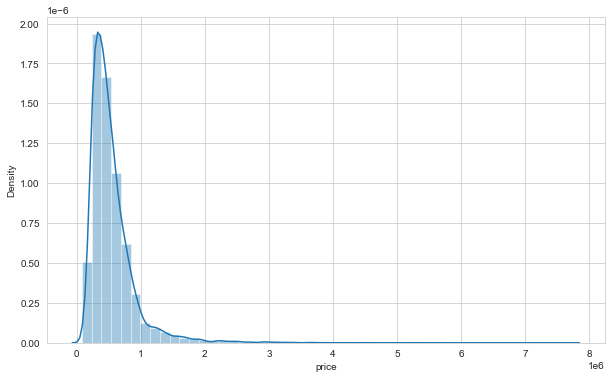

In [62]:
sns.distplot(df['price']);

3000000' den buyuk evleri DataFrame olarak price' a gore siraladik. Ilk siraya baktigimizda evin fiyati cok yuksek fakat grade, condition, view degerleri de yuksek. Eger bunlar dusuk olsaydi supheli bir durum olabilirdi gibi tek tek degerlendirmelerimizi yaptik; herhangi bir problem olmadigina karar verdik:

In [63]:
df[df["price"] > 3000000].sort_values(by="price", ascending=False)

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
7245,10/13/2014,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,98102,47.630,-122.323,3940,8800
3910,6/11/2014,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,98004,47.650,-122.214,3930,25449
9245,9/19/2014,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,98039,47.630,-122.240,4540,42730
4407,8/4/2014,5570000.000,5,5.750,9200,35069,2.000,0,0,3,13,6200,3000,2001,0,98039,47.629,-122.233,3560,24345
1446,4/13/2015,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,98004,47.623,-122.220,4600,21750
1313,4/13/2015,5300000.000,6,6.000,7390,24829,2.000,1,4,4,12,5000,2390,1991,0,98040,47.563,-122.210,4320,24619
1162,10/20/2014,5110000.000,5,5.250,8010,45517,2.000,1,4,3,12,5990,2020,1999,0,98033,47.677,-122.211,3430,26788
8085,6/17/2014,4670000.000,5,6.750,9640,13068,1.000,1,4,3,12,4820,4820,1983,2009,98040,47.557,-122.210,3270,10454
2624,8/15/2014,4500000.000,5,5.500,6640,40014,2.000,1,4,3,12,6350,290,2004,0,98155,47.749,-122.280,3030,23408
8629,6/18/2014,4490000.000,4,3.000,6430,27517,2.000,0,0,3,12,6430,0,2001,0,98004,47.621,-122.219,3720,14592


Denize yakinlik durumlarina gore evlerin durumlarini inceledik. Evin denize yakin olup olmamasi fiyati oldukca etkiliyor :

In [64]:
df.groupby("waterfront").mean().T

waterfront,0,1
price,531762.324,1662524.184
bedrooms,3.374,3.301
bathrooms,2.112,2.678
sqft_living,2072.007,3173.687
sqft_lot,15021.290,25371.828
floors,1.493,1.641
view,0.207,3.767
condition,3.409,3.534
grade,7.649,8.773
sqft_above,1783.392,2473.043


Price' i en cok etkileyen feature' lara baktik. Yasam alani, evin kalitesi gibi faktorler fiyati en cok etkileyen faktorler. sqft_living sutununda bir feature engineering yapilmis. sqft_basement (bodrumun yüzölcümü) ile sqft_above (yaşam alani)' nin toplami sqft_living' i veriyor :

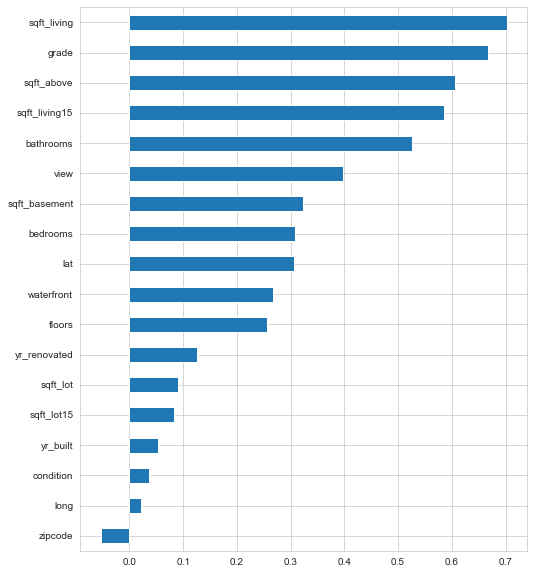

In [65]:
plt.figure(figsize = (8,10))
df.corr()["price"].sort_values().drop("price").plot(kind = "barh");

price ile en yuksek corr iliskisi olan sqft_living sutununun scatterplot' una baktik, hue olarak da grade' i verdik. Renklere bakarak sqft_living ve grade arttikca price' in da arttigini renklerin gittikce koyulasmasindan anliyoruz :

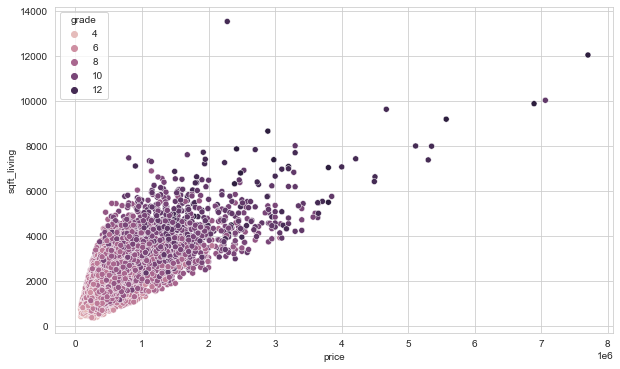

In [66]:
sns.scatterplot(x = 'price',y = 'sqft_living', data = df, hue = "grade");

### bedrooms

Yatak odalarinin geneli 3 fakat 33 ve 11 gibi uc degerler de var :

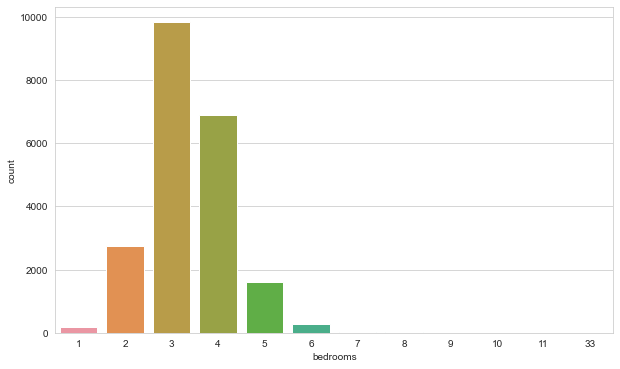

In [67]:
sns.countplot(df['bedrooms']);

Yatak odalarina price' a gore boxplot ile baktik. 33 ve 11 yatak odalarinin fiyatlarinin cok dusuk oldugunu goruyoruz. (3 yerine 33 yazilmis olabilir) :

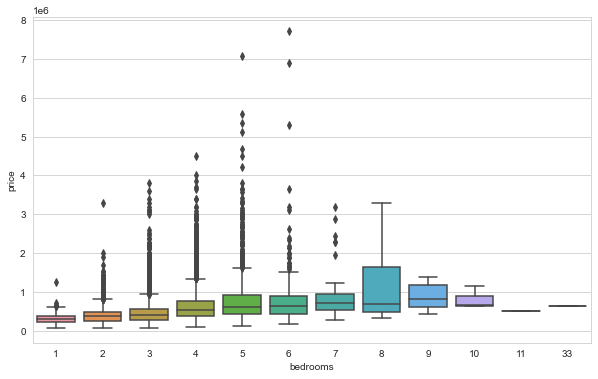

In [68]:
sns.boxplot(x = 'bedrooms', y = 'price', data = df);

10' dan fazla yatak odasi olan evlerin ozelliklerine baktik. 11 odali evde 3 banyo var iken, 33 odali evde 1.75 banyo var. Bu olamayacagi icin 33 yatak odali sutunu drop edecegiz :

In [69]:
df[df["bedrooms"] > 10]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
8748,8/21/2014,520000.000,11,3.000,3000,4960,2.000,0,0,3,7,2400,600,1918,1999,98106,47.556,-122.363,1420,4960
15856,6/25/2014,640000.000,33,1.750,1620,6000,1.000,0,0,5,7,1040,580,1947,0,98103,47.688,-122.331,1330,4700


In [70]:
df = df[df["bedrooms"] != 33]

Most likely the data was entered incorrectly.

In [71]:
df.shape

(21596, 20)

### date

Time series bir data ile ugrasiyor olsaydik date sütununu index sutununa tasiyabilirdik. Burda ise yillara aylara bolerek inceleyecegiz :

In [72]:
df['date'].dtype    #type' i object (str)

dtype('O')

Once datetime' a cevirecegiz, sonra da yil ve ay bilgilerini cekerek feature engineering yapacagiz :

In [73]:
df['date'] = pd.to_datetime(df['date'])

In [74]:
df['date']

0       2014-10-13
1       2014-12-09
2       2015-02-25
3       2014-12-09
4       2015-02-18
           ...    
21592   2014-05-21
21593   2015-02-23
21594   2014-06-23
21595   2015-01-16
21596   2014-10-15
Name: date, Length: 21596, dtype: datetime64[ns]

dt.year ile her sutundaki yil bilgisini aldik :

In [75]:
df['year'] = df['date'].dt.year
#df['year'] = df['date'].apply(lambda date : date.year)    --> Bu kod da ayni islemi yapar.

dt.month ile her sutundaki ay bilgisini aldik :

In [76]:
df['month'] = df['date'].dt.month

year ve month bilgiler datamizin sonuna sütun olarak eklendi :

In [77]:
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month
0,2014-10-13,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650,2014,10
1,2014-12-09,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639,2014,12
2,2015-02-25,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062,2015,2
3,2014-12-09,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000,2014,12
4,2015-02-18,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503,2015,2


year sutununu price'a gore boxplot ile inceledik. 2014 ile 2015 arasinda cok bir fark yok. Buradan cok fazla bir inside elde edemedik :

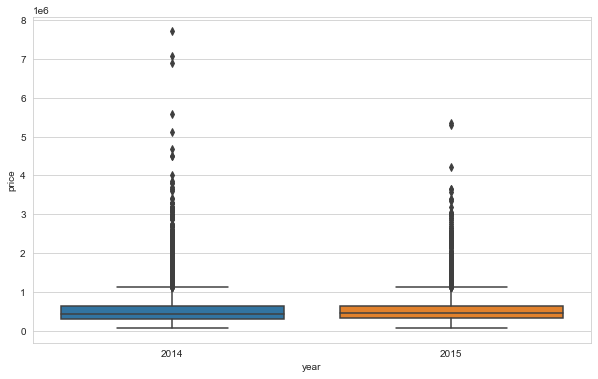

In [78]:
sns.boxplot(x = 'year', y = 'price', data = df);

year' a gore gruplama yapip price' in ortalamasini alarak bir gorsel elde ettik. 2014' teki ortalama fiyatlar 539500 civarinda iken 2015' deki ortalama fiyatlar 542000 civarinda. Aralarinda yaklasik 25000 dolarlik az bir fark var :

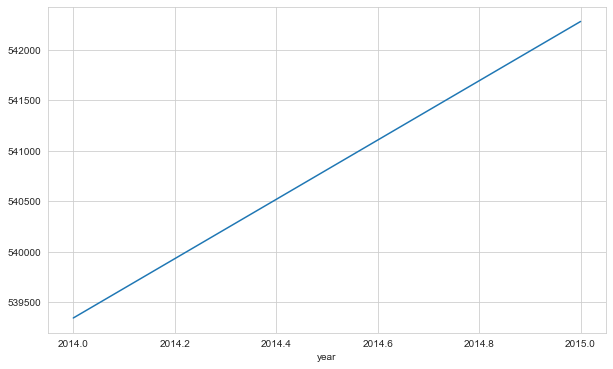

In [79]:
df.groupby('year')['price'].mean().plot();

month sutununu price'a gore boxplot ile inceledik. Yine buradan cok fazla bir inside elde edemedik :

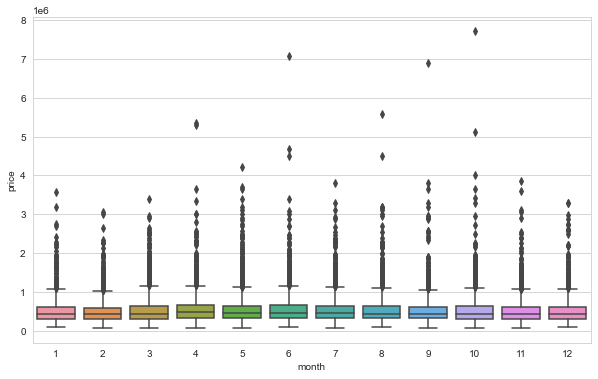

In [80]:
sns.boxplot(x = 'month', y = 'price', data = df);

month' a gore gruplama yapip price' larin ortalamasini aldik ve lineplot' larina baktik. En dusuk fiyat ile en yuksek fiyat arasinda cok buyuk bir fark olmasa da bahar aylarinda evlerin fiyatlari artiyor diyebiliriz. Kesin bilgi icin domain knowledge' a ihtiyac var :

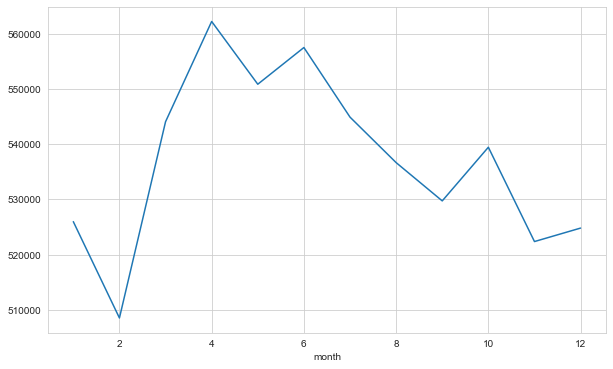

In [81]:
df.groupby('month')['price'].mean().plot();

Aylarin birbirine karsi bir ustunlugu olmadigi icin get_dummy yontemi uygulamak mantikli olur. get_dummy isleminden sonra datamiz ile dummy' li aylari concat ettik :

In [82]:
month_dummy = pd.get_dummies(df["month"], prefix = "month")
df = pd.concat([df, month_dummy], axis = 1)
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,2014-10-13,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650,2014,10,0,0,0,0,0,0,0,0,0,1,0,0
1,2014-12-09,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639,2014,12,0,0,0,0,0,0,0,0,0,0,0,1
2,2015-02-25,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062,2015,2,0,1,0,0,0,0,0,0,0,0,0,0
3,2014-12-09,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000,2014,12,0,0,0,0,0,0,0,0,0,0,0,1
4,2015-02-18,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503,2015,2,0,1,0,0,0,0,0,0,0,0,0,0


Tarih bilgisi olarak aylari kullanmaya karar verdik, cunku bize daha fazla inside sagladi. Bu yuzden year sutununu ve ihtiyacimiz kalmayan diger sutunlari dropladik :

In [83]:
df = df.drop(['date', "year", "month"], axis = 1)

### zipcode

Zipcode onemli bir veri cunku evlerin bulundugu ilceye gore ev fiyatlari degisir ama burada 70 cesit zipcode var. Bunlari kullanmak istesek get_dummy islemi uygulamamiz gerekir fakat cok fazla unique deger oldugu icin bu uygun olmaz. Eger alan hakkinda yeterli domain bilgisi varsa gruplandirma yapilarak cesit azaltilabilir. Fakat bizim domain bilgimiz de olmadigi icin ve elimizde zaten koordinat bilgileri oldugu icin bu sutunu drop edecegiz :

In [84]:
df['zipcode'].value_counts(dropna = False)

98103    601
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

we can categorize the zipcodes as north, south, west, east, middle by regions. But it can be made manually and taken many time and we need domain knowladge to do that. So we will drop this column.

In [85]:
df = df.drop('zipcode', axis = 1)

### yr_renovated & yr_built

0 yazanlar yenilenme gecirmeyen evleri temsil ediyor :

In [86]:
df['yr_renovated'].value_counts(dropna = False)

0       20682
2014       91
2013       37
2003       36
2005       35
        ...  
1951        1
1959        1
1948        1
1954        1
1944        1
Name: yr_renovated, Length: 70, dtype: int64

Her evin insa yili mevcut. yenilenme ve insa yili bilgileri aynen muhafaza edilebilir. Data modellemeden once scale edilecegi icin skorlari olumsuz etkilemeyecektir cunku tum degerler 0 ile 1 arasina tasinmis olacak :

In [87]:
df['yr_built'].value_counts(dropna = False)

2014    559
2006    453
2005    450
2004    433
2003    420
       ... 
1933     30
1901     29
1902     27
1935     24
1934     21
Name: yr_built, Length: 116, dtype: int64

could make sense due to scaling, higher should correlate to more value

Insa yili ile yenilenmeyi birlestirerek tek bir sutun cikarsak nasil olur diye dusunduk.Once renovated' i 0 olanlari nun degere cevirdik. nun degerleri de built sutunlari ile doldurduk. Bu durumda evler yenilendiyse tarihler yenilenme tarihleri, yenilenmediyse de insa tarihleri olmus oldu. Daha sonra da built sutununu dusurduk. Fakat skorlari etkilemedigini gordugumuz icin bu islemden vazgectik :

In [88]:
# df["yr_renovated"].replace(0, np.nan, inplace = True)
# df["yr_renovated"].fillna(df["yr_built"], inplace = True)
# df.drop("yr_built", axis = 1, inplace = True)

Bir de yukaridaki islemin aynisini yapip yili yasa cevirerek sadece yas sutununu kullandik, built ve renovated sutunlarini sildik. Bu islemden sonra da cok farkli bir skor elde etmedik. Renovated' tan ne kastedildigini de tam bilmiyoruz; evin sadece bir bolumu yenilenmis olabilir, bazi evlerin ise tamami yenilenmis olabilir :

In [89]:
# df["yr_renovated"].replace(0, np.nan, inplace = True)
# df["yr_renovated"].fillna(df["yr_built"], inplace = True)
# df["new_age"] = 2021 - df["yr_renovated"]
# df.drop(["yr_renovated", "yr_built"], axis = 1, inplace = True)

### sqft_basement

0 olanlar, bodrumu olmayan evler :

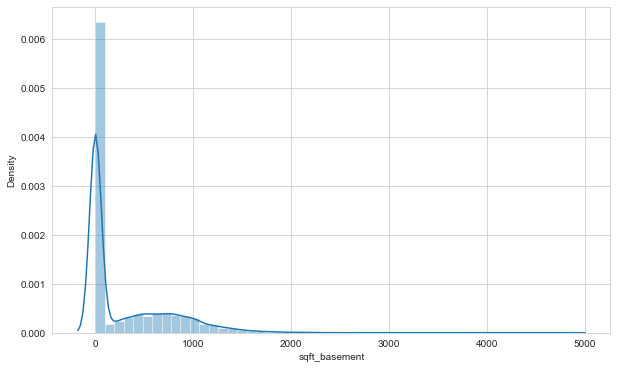

In [90]:
sns.distplot(df['sqft_basement']);

13110 tane evin bodrumu yok. Bodrumu olanlarin da yuzolcumleri verilmis :

In [91]:
df['sqft_basement'].value_counts(dropna = False)

0      13110
600      221
700      218
500      214
800      206
       ...  
518        1
374        1
784        1
906        1
248        1
Name: sqft_basement, Length: 306, dtype: int64

Bodrumunun yuzolcumu 3000' den buyuk olanlara azalan sirada baktik. Basement' in buyuklugune gore oda sayilari orantili mi veya basement alani ile sqft_living orantili mi diye de bakilabilir ve extreme degerler bu sekilde belirlenebilir. Burada herhangi bir problem gormedik :

In [92]:
df[df["sqft_basement"] > 3000].sort_values(by="sqft_basement", ascending=False)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
8085,4670000.000,5,6.750,9640,13068,1.000,1,4,3,12,4820,4820,1983,2009,47.557,-122.210,3270,10454,0,0,0,0,0,1,0,0,0,0,0,0
12764,2280000.000,7,8.000,13540,307752,3.000,0,4,3,12,9410,4130,1999,0,47.667,-121.986,4850,217800,0,0,0,0,1,0,0,0,0,0,0,0
15468,3200000.000,4,3.250,7000,28206,1.000,1,4,4,12,3500,3500,1991,0,47.593,-122.086,4913,14663,0,0,0,0,0,0,0,1,0,0,0,0
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
10074,1900000.000,5,4.250,6510,16471,2.000,0,3,4,11,3250,3260,1980,0,47.576,-122.242,4480,16471,0,0,0,0,0,0,0,0,1,0,0,0


could make sense due to scaling, higher should correlate to more value

### sqft_above

Grafige gore yasam alani 6000' den yukari olan degerlerde extreme durumlar olabilir, bunlara bakacagiz :

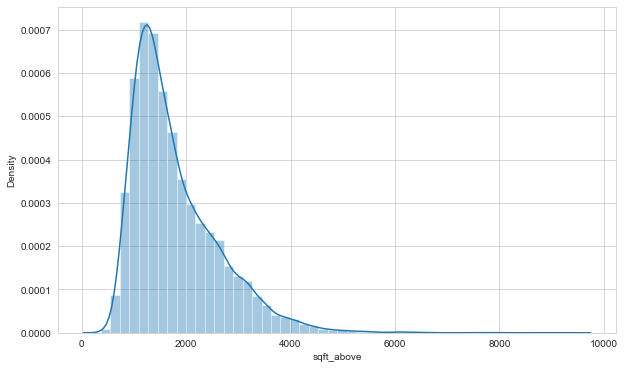

In [93]:
sns.distplot(df['sqft_above']);

In [94]:
df['sqft_above'].value_counts(dropna = False)

1300    212
1010    210
1200    206
1220    192
1140    184
       ... 
3674      1
2979      1
2382      1
6290      1
1425      1
Name: sqft_above, Length: 942, dtype: int64

Yasam alani 6000' den buyuk olan sutunlarda da toplam yasam alani olan sqft_living sutunu acisindan bir sıkıntı gorulmuyor. Yasam alanlari ile oda sayilari da orantili. Bu yuzden bu sutunda herhangi bir islem yapmayacagiz :

In [95]:
df[df["sqft_above"] > 6000].sort_values(by="sqft_above", ascending=False)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
12764,2280000.000,7,8.000,13540,307752,3.000,0,4,3,12,9410,4130,1999,0,47.667,-121.986,4850,217800,0,0,0,0,1,0,0,0,0,0,0,0
9245,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,47.630,-122.240,4540,42730,0,0,0,0,0,0,0,0,1,0,0,0
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
18288,3300000.000,5,6.250,8020,21738,2.000,0,0,3,11,8020,0,2001,0,47.568,-122.189,4160,18969,0,0,0,0,0,0,1,0,0,0,0,0
13398,2420000.000,5,4.750,7880,24250,2.000,0,2,3,13,7880,0,1996,0,47.733,-122.362,2740,10761,1,0,0,0,0,0,0,0,0,0,0,0
19842,2700000.000,4,4.000,7850,89651,2.000,0,0,3,12,7850,0,2006,0,47.541,-121.982,6210,95832,1,0,0,0,0,0,0,0,0,0,0,0
3910,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,47.650,-122.214,3930,25449,0,0,0,0,0,1,0,0,0,0,0,0
11859,1950000.000,4,3.250,7420,167869,2.000,0,3,3,12,7420,0,2002,0,47.455,-121.764,5610,169549,1,0,0,0,0,0,0,0,0,0,0,0
18579,1140000.000,5,4.000,7320,217800,2.000,0,0,3,11,7320,0,1992,0,47.447,-122.086,3270,34500,0,0,0,0,0,0,1,0,0,0,0,0
1446,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,47.623,-122.220,4600,21750,0,0,0,1,0,0,0,0,0,0,0,0


### Geographical Properties

Boylam sütununun price' a gore scatterplot' una baktik. -122 boylami civarinda ev fiyatlarinin daha yuksek oldugunu goruyoruz :

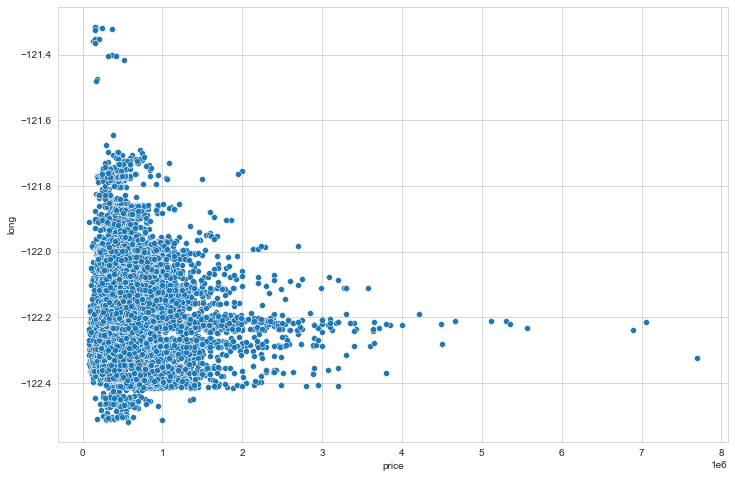

In [96]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'price', y = 'long', data = df);

Enlem sütununun price' a gore scatterplot' una baktik. 47.6 ile 47.7 enlemleri arasinda ev fiyatlarinin yuksek oldugunu goruyoruz :

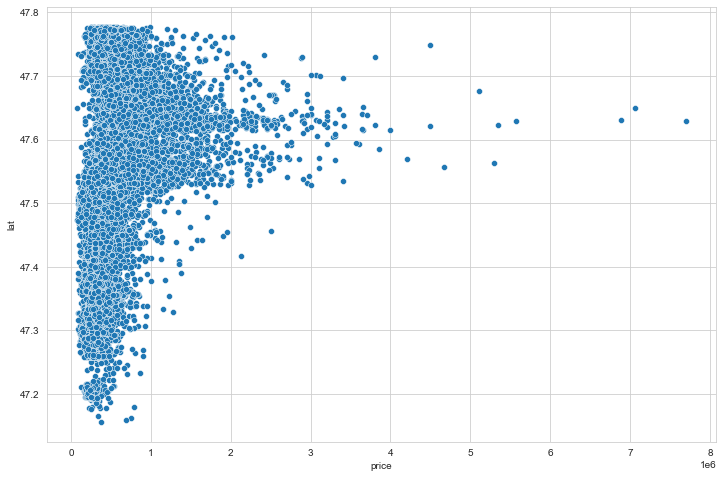

In [97]:
plt.figure(figsize  = (12, 8))
sns.scatterplot(x = 'price', y = 'lat', data = df);

Enlem ve boylam sutunlarini birlestirerek fiyatlarina baktik. Karsimiza bir harita cikti. Bos olan yerlerde muhtemelen su var. Koyu renkli olan yerler, ev fiyatlarinin yuksek olduklari yerler. Burada fiyata gore renk degisimini cok net goremiyoruz. Bu yuzden birtakim islemler yapacagiz :

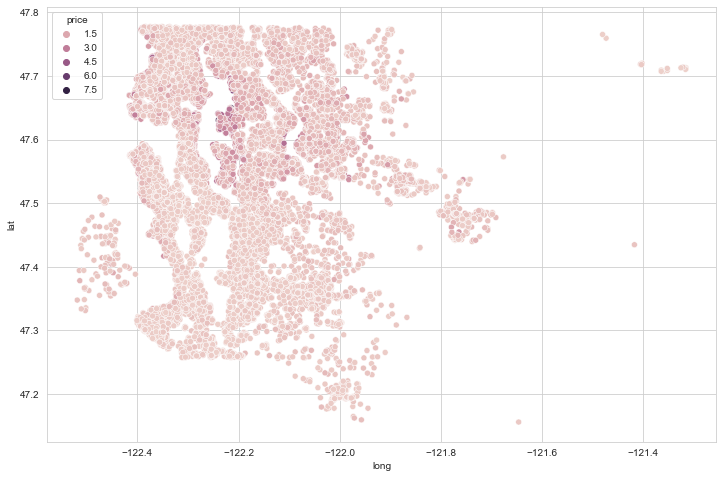

In [98]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'long', y = 'lat', data = df, hue = 'price');

Datamizin %1' i 216 satir imiş : 

In [99]:
len(df) * (0.01)

215.96

Datamizi price' a gore azalan sirada siraladik ve ilk 216 satiri aldik. Fiyati 1970000' de buyuk olan evler geldi :

In [100]:
df.sort_values('price', ascending = False).head(216)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
3910,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,47.650,-122.214,3930,25449,0,0,0,0,0,1,0,0,0,0,0,0
9245,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,47.630,-122.240,4540,42730,0,0,0,0,0,0,0,0,1,0,0,0
4407,5570000.000,5,5.750,9200,35069,2.000,0,0,3,13,6200,3000,2001,0,47.629,-122.233,3560,24345,0,0,0,0,0,0,0,1,0,0,0,0
1446,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,47.623,-122.220,4600,21750,0,0,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7408,1980000.000,6,4.500,4800,9097,2.000,0,0,3,10,3580,1220,2007,0,47.626,-122.291,2180,6037,0,0,0,0,0,0,1,0,0,0,0,0
16511,1980000.000,4,3.500,4500,44384,1.000,0,0,3,12,3340,1160,1990,0,47.632,-122.192,2540,26287,0,1,0,0,0,0,0,0,0,0,0,0
19513,1980000.000,4,4.000,4360,12081,2.000,0,0,3,10,4360,0,2007,0,47.638,-122.219,2180,10800,0,0,0,0,0,0,0,1,0,0,0,0
3278,1970000.000,5,3.750,3940,13738,1.500,0,3,4,9,3940,0,1951,0,47.620,-122.212,2370,13320,0,1,0,0,0,0,0,0,0,0,0,0


En pahali bu 216 evi DataFrame' den cikartarak tekrar bir gorsel aldik. Bunun icin yeni bir degisken olusturduk. df' i price' a gore azalan sirada siraladik ve ilk 216 ev haric sonrakilere ait bir  gorsel aldik :

In [101]:
non_top_1_perc = df.sort_values('price', ascending = False).iloc[216:]
non_top_1_perc

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
17221,1970000.000,8,3.500,4440,6480,2.000,0,3,5,10,3140,1300,1959,0,47.631,-122.303,4440,8640,0,0,0,0,1,0,0,0,0,0,0,0
9166,1960000.000,3,1.750,3330,12566,1.000,1,4,4,8,1940,1390,1960,0,47.529,-122.220,3730,16560,0,1,0,0,0,0,0,0,0,0,0,0
12565,1960000.000,4,4.000,4430,31353,2.000,0,0,3,12,4430,0,1998,0,47.642,-122.157,3900,35237,0,0,0,1,0,0,0,0,0,0,0,0
1150,1960000.000,4,2.750,3120,7898,1.000,1,4,4,8,1560,1560,1963,0,47.717,-122.259,2630,13868,0,0,0,1,0,0,0,0,0,0,0,0
12271,1960000.000,5,4.500,6200,23373,3.000,0,1,4,11,5050,1150,1988,0,47.563,-122.215,3700,14486,0,0,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2139,82500.000,2,1.000,520,22334,1.000,0,0,2,5,520,0,1951,0,47.480,-122.296,1572,10570,0,0,0,0,1,0,0,0,0,0,0,0
8267,82000.000,3,1.000,860,10426,1.000,0,0,3,6,860,0,1954,0,47.499,-122.341,1140,11250,0,0,0,0,0,0,0,0,0,0,1,0
16184,81000.000,2,1.000,730,9975,1.000,0,0,1,5,730,0,1943,0,47.481,-122.315,860,9000,0,0,1,0,0,0,0,0,0,0,0,0
465,80000.000,1,0.750,430,5050,1.000,0,0,2,4,430,0,1912,0,47.650,-121.909,1200,7500,0,0,0,0,1,0,0,0,0,0,0,0


En pahali 216 ev haric diger evlerin enlem ve boylama gore price gorselini olusturduk. Renkler ve saydamlikla oynayarak gorseli de zenginlestirdik. Yesil noktadaki evler daha pahali, kirmiziya gittikce ise evlerin fiyatlari dusuyor. Gorsele bakarak bazi deniz kenarindaki evlerin ucuz oldugunu, deniz kenarinda olmayan evlerinde pahali oldugunu soyleyebiliriz. Asagida bu gorsele daha ayrintili bakacagiz :

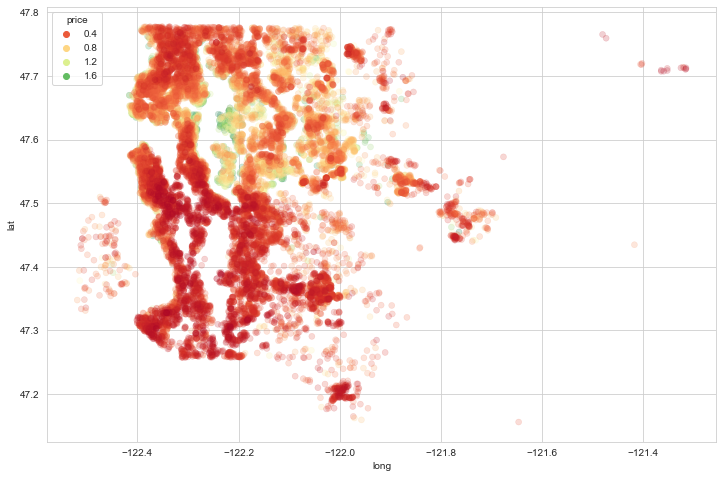

In [102]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'long', y = 'lat', data = non_top_1_perc, hue = 'price',
                palette = 'RdYlGn', edgecolor = None, alpha = 0.2);

Denize yakinlik ile price arasindaki iliskiye baktik. Deniz kenarindaki evler genel olarak daha pahali :

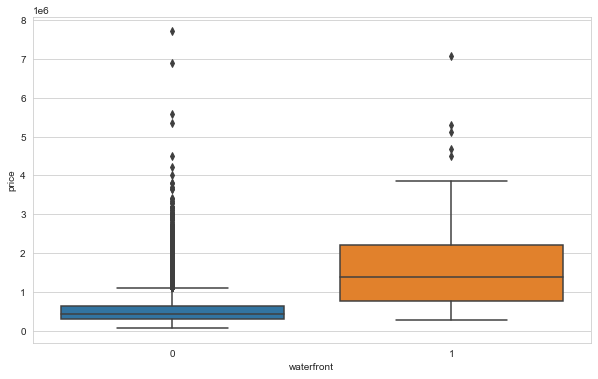

In [103]:
sns.boxplot(x = 'waterfront', y = 'price', data = df);

Asagidaki haritada Dunya' daki tum yerler mevcut. Biz haritamizin icine, lat ve long sütunlarinin ortalama degerlerini verdik. Bu sekilde haritanin merkezi bu enlem ve boylam bilgileri olacak sekilde bir ayarlama yapildi. zoom_start ise baslangic zoom' u, bu bilgiyi girmesek de olur cunku harita uzerinden de zoom yapabiliyoruz. Bir sonraki kodda harita uzerine verilerimizi yerlestirecegiz :

In [104]:
import folium
folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start=10)

Yukaridaki koda ek olarak for dongusu ile datadaki herbir nokta harita uzerine islenecek. (Bu kodu ezbere bilmeye gerek yok, herhangi bir datasetinde kullanilabilir) :

In [105]:
map_kc = folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start = 10) # location=[47.511,  -122.257]
for lat, lng in zip(df['lat'], df['long']):
    folium.CircleMarker(
        [lat, lng],
        radius = 1,
        color = 'blue',
        fill = False ,
        fill_color ='#3186CC',
        fill_opacity = 0.3).add_to(map_kc)
map_kc

min-max ve ortanca degerlere gore renklendirilmis harita :

In [106]:
#her noktayi farkli renkte harita uzerine yerlestir.
import branca.colormap as cm

min_price = df['price'].min()
max_price = df['price'].max()

map_kc = folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start = 10) # location=[47.511,  -122.257]

myColors = cm.StepColormap(colors=['green','yellow','orange','red'],  
                           #index << min, 25%, 50%, 75%, max
                           index=[min_price,322000,450000,645000,max_price], 
                           vmin= min_price,
                           vmax=max_price)

for loc, prc in zip(zip(df['lat'], df['long']), df['price']):
      folium.CircleMarker(
        loc,
        radius = 1,
        fill=True, 
        color= myColors(prc)
      ).add_to(map_kc)
map_kc

### latest data

In [143]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,47.511,-122.257,1340,5650,0,0,0,0,0,0,0,0,0,1,0,0
1,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,47.721,-122.319,1690,7639,0,0,0,0,0,0,0,0,0,0,0,1
2,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,47.738,-122.233,2720,8062,0,1,0,0,0,0,0,0,0,0,0,0
3,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,47.521,-122.393,1360,5000,0,0,0,0,0,0,0,0,0,0,0,1
4,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,47.617,-122.045,1800,7503,0,1,0,0,0,0,0,0,0,0,0,0


In [144]:
df.shape

(21596, 30)

## Preprocessing of Data
- Train | Test Split, Scalling

In [145]:
from sklearn.model_selection import train_test_split

In [146]:
X = df.drop('price', axis = 1)
y = df['price']

Baslangicta seed diye bir degiskene 101 degerini atadik. DL' de agirliklar random atandigi icin her seferinde farkli sonuclar alabiliriz. Hep ayni sonuclari almak icin bu degeri random_state' e atayacagiz :

In [147]:
seed = 101

Datamizin %10' luk kismini teste ayirdik. Datamizi 3' e bolecegiz (train, test, validation). Burada train ve test kismini bolduk; validation kismini ise modelin icinde bolecegiz :

In [148]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=seed)

In [149]:
from sklearn.preprocessing import MinMaxScaler  # RobustScaler()

# If there are too many outliers in the data, robust scaler should be used, otherwise minmax can be used.

Datamizda extreme degerler oldugu icin Robust scaler da kullanilabilirdi fakat bu data icin skorlarda cok fazla bir fark olmadigi icin MinMaxScaler kullandik :

In [150]:
scaler = MinMaxScaler()

In [151]:
X_train= scaler.fit_transform(X_train)   # X_train icin fit-transform islemi
X_test = scaler.transform(X_test)        #y_train icin sadece transform islemi

## Modelling & Model Performance

Arka arkaya katmanlari olusturabilmek icin Sequential' i, layer isimlerini import ettik ve degerlendirme metriklerimizi import ettik ve eval_metric fonksiyonumuzu tanimladik :

In [152]:
#pip install tensorflow

In [153]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation

In [154]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score

In [155]:
def eval_metric(actual, pred):
    mae = mean_absolute_error(actual, pred)
    mse = mean_squared_error(actual, pred)
    rmse = np.sqrt(mean_squared_error(actual, pred))
    score = r2_score(actual, pred)
    return print("r2_score:", score, "\nmae:", mae, "\nmse:", mse, "\nrmse:", rmse)

In [156]:
X_train.shape

(19436, 29)

Modelimizi Sequential ile tanimladik. 29 tane input' umuz var. Ilk inputta ve sonraki katmanda 29 nöron kullandik sonraki katmanlarda da bu sayiyi yariya dusurerek gittik. Outputta ise regression problemi ile ugrastigimiz icin tek bir nörona dusurerek yapimizi kurduk.

input_dim' i input kisminda tanimladik, X_train.shape' in ilkini yani 29' u aldik (Bunu tanimlamasak da olur). Aktivasyon fonksiyonu olarak da 'relu' yu tanimladik :

In [157]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))  
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

# Yukarida structer' i kurduk, asagida da icerisinde isleyecek sistemi soyledik.
# Regression problemi oldugu icin mse sectik :

model.compile(optimizer = 'adam', loss = 'mse')

__model.add(Activation("relu"))__
Aktivasyon fonksiyonlari kodun icine yazmak yerine ayri olarak boyle de tanimlanabilir.

input_dim kismini input layer' da tanimlamasak da olur ama o zaman asagidaki gibi model.weights ciktisini alamayiz; bunu ancak fit isleminde gorebiliriz. Fakat input kisminda bunu tanimlarsak model icinde 29 sütun olacagi bilgisini bastan verdigimiz icin input layer' da 29 tane nöron olmasi gerektigi bilgisine bastan ulasmis olur ve agirliklari egitimden once de gorebiliriz : 

In [158]:
model.weights

[<tf.Variable 'dense_5/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[-1.70324743e-02, -1.51578441e-01, -3.13210070e-01,
         -1.69344082e-01, -2.32419372e-03,  1.83119476e-01,
          3.12089741e-01,  1.32420003e-01, -7.77235925e-02,
         -1.80055380e-01,  1.37490690e-01,  2.44639575e-01,
          2.31555283e-01, -6.62986040e-02, -2.74564326e-02,
         -1.35668695e-01,  2.61596382e-01,  8.22164118e-02,
          5.58787882e-02, -2.51106918e-01, -5.92915118e-02,
          2.22223699e-01,  2.98478782e-01, -2.02705756e-01,
         -7.43545145e-02,  4.26854789e-02,  1.53914899e-01,
          2.50992417e-01, -3.05378854e-01],
        [ 6.67949915e-02,  2.71055698e-01,  3.84545326e-02,
          9.87240672e-02,  4.28160727e-02,  3.17192078e-01,
          1.78963125e-01, -2.03873098e-01,  2.77073383e-02,
         -3.17017347e-01,  1.53067470e-01, -2.94106930e-01,
         -8.02034587e-02, -8.54518265e-02,  2.60613561e-01,
          8.22514594e-02,  3.08114409e-01, -1.

Yukarida datanin %10' unu test datasi olarak ayirmistik. Asagida da train setinde sondaki %15' lik kismi validation datasi olarak ayir dedik. Validation kismi egitime girmeyecek, geri kalan kisim egitim islemine girecek. 

Data 1000 kere model ile egitilecek ve her Epoch baslangicinda data tekrar karılacak. Her 128 satirda bir backpropagation yaparak (hatalarin ortalamasi alinarak geriye donup agirliklari ve bias' leri guncelleme islemi) egitimi tamamlayacak.

Ciktidaki ilk satirda 128 satirlik bir model olusmus oldu. Buradaki egitimde X_train ve y_train' e gore __loss__ skoru olustu (130. skorun yani son islemin loss skoru). Sonra ayni modele validation datasi verilerek __val_loss__ skoru olustu. Bu iki skor kiyaslanarak overfit underfit durumu var mi yok mu durumunu kiyaslayabiliriz. Her Epoch sonunda validation datasi verilerek bu sekilde yeni skorlar alinir :

__Ciktidaki 130 :__ Egitime giren data / batch_size = 130 cikti. 128 sample' de bir backpropagation yap dedigimiz icin 128 sample' da bir bu islemi yapacak, bu da 130 isleme tekabul ediyor. (130 kere iterasyon)

In [159]:
model.fit(x = X_train, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000)

Epoch 1/1000
130/130 [==============================] - 2s 6ms/step - loss: 428612583424.0000 - val_loss: 423995375616.0000
Epoch 2/1000
130/130 [==============================] - 1s 4ms/step - loss: 428064899072.0000 - val_loss: 422000689152.0000
Epoch 3/1000
130/130 [==============================] - 1s 4ms/step - loss: 419530309632.0000 - val_loss: 402201968640.0000
Epoch 4/1000
130/130 [==============================] - 1s 5ms/step - loss: 374767910912.0000 - val_loss: 326337691648.0000
Epoch 5/1000
130/130 [==============================] - 1s 4ms/step - loss: 262120374272.0000 - val_loss: 190364090368.0000
Epoch 6/1000
130/130 [==============================] - 0s 3ms/step - loss: 139063623680.0000 - val_loss: 111865782272.0000
Epoch 7/1000
130/130 [==============================] - 0s 3ms/step - loss: 100212514816.0000 - val_loss: 104871731200.0000
Epoch 8/1000
130/130 [==============================] - 0s 2ms/step - loss: 97036533760.0000 - val_loss: 103696465920.0000
Epoch 9/1

Toplamda 2327 tane parametremiz var. Her satirda 130 iterasyon olmustu ve bu islemler 1000 kere tekrar etmisti. Yani toplamda 130*1000=130000 kere islem yapildi. 2327 parametre de 130000 kere guncellenmis oldu :

In [160]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 29)                870       
                                                                 
 dense_6 (Dense)             (None, 29)                870       
                                                                 
 dense_7 (Dense)             (None, 15)                450       
                                                                 
 dense_8 (Dense)             (None, 8)                 128       
                                                                 
 dense_9 (Dense)             (None, 1)                 9         
                                                                 
Total params: 2,327
Trainable params: 2,327
Non-trainable params: 0
_________________________________________________________________


Egitim oncesi agirlik degerlerimizi yukarida yazdirmistik. Asagida da egitim sonrasi alinan agirlik degerlerini goruyoruz :

In [161]:
model.weights

[<tf.Variable 'dense_5/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[-3.57990503e-01, -1.27269912e+00, -9.25332785e-01,
         -9.64973629e-01, -6.70878470e-01, -9.18046892e-01,
         -9.69202459e-01, -9.92194653e-01, -8.90927851e-01,
         -6.37709200e-01, -1.36409628e+00, -2.27929544e+00,
          1.30694106e-01, -8.50844026e-01,  1.07578278e+00,
         -5.67448020e-01, -5.10551095e-01, -6.08951926e-01,
         -1.06017053e+00, -1.41360617e+00, -7.27310836e-01,
         -9.36256424e-02, -1.14907503e+00, -8.29647481e-01,
         -5.31477511e-01,  1.69008821e-01,  6.57015324e-01,
          8.17061484e-01, -6.76818788e-01],
        [ 8.25431168e-01,  9.89841878e-01, -4.75256801e-01,
          7.38061786e-01,  5.68125367e-01,  8.85649562e-01,
          7.01742530e-01,  3.63545895e-01,  3.48220205e+00,
          4.32868868e-01,  1.80482674e+00,  1.40142262e+00,
         -1.78282961e-01,  1.84451091e+00,  1.47637293e-01,
          2.78463459e+00,  1.90287268e+00,  5.

model.history.history ile yukarida egitim kodunda aldigimiz loss ve val_los degerlerini alabiliriz. Bunu da DataFrame' e cevirip gorsellestirerek bir kiyaslama yapabiliriz :

In [162]:
pd.DataFrame(model.history.history)

,loss,val_loss
0,428612583424.000,423995375616.000
1,428064899072.000,422000689152.000
2,419530309632.000,402201968640.000
3,374767910912.000,326337691648.000
4,262120374272.000,190364090368.000
...,...,...
995,21423456256.000,25837352960.000
996,21383440384.000,25849792512.000
997,21371013120.000,25771218944.000
998,21317382144.000,25782839296.000


Egitim datasindan alinan skorlar ile (loss) validation datasindan alinan hata skorlarinin birbirleriyle orantili bir sekilde azalmasi istedigimiz bir durumdu. Asagida da bu basariyi goruyoruz :

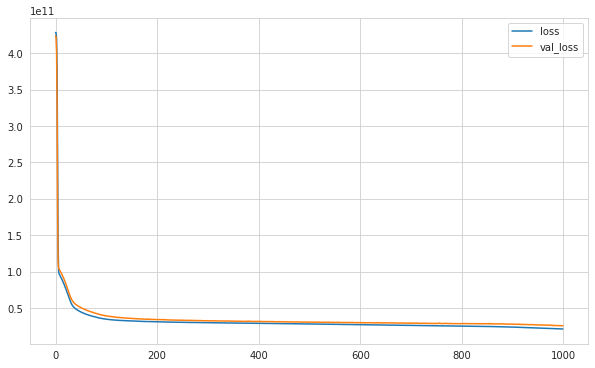

In [163]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot();

__model.evaluate__ ciktisinda aldigimiz deger, yukarida compile kisminda tanimladigimiz loss='mse' skorudur. Oraya hangi skor tanimlandiysa burda o sonucu aliriz. Fakat bu skor mae' nin karesi oldugu icin tam bir yorum yapamiyoruz. Bu yuzden skorlarimiza eval_metric fonk. ile bakacagiz :

In [164]:
model.evaluate(X_test, y_test, verbose=0)

19593125888.0

Yukarida hep validation datasi ile overfit underfit durumuna bakmistik. Ilk defa burada prediction asamasinda X_test devreye girmis oldu :

In [165]:
y_pred = model.predict(X_test)

mae' ye gore yaklasik 84 binlik hata var :

In [166]:
eval_metric(y_test, y_pred)

r2_score: 0.8475003252372737 
mae: 83880.94496889468 
mse: 19593121909.007133 
rmse: 139975.4332338612


### learning_rate

__learning_rate,__ global min degerine ulasmak icin ne kadar buyuk bir adim atmamiz gerektigini belirler. Turev alindiktan sonra egim degeri learning rate ile carpilarak adim buyuklugu elde edilir. (learning_rate default=0.001)

Yukaridaki plot grafiginde modelin bir degere kadar hizli ogrendigini sonrasinda ise yavaslayarak egitimin az da olsa devam ettigini goruyoruz. Epoch sayisini artirarak egitim suresi uzatilabilir veya learning rate artirilarak yine 1000 epoch degerinde daha hizli adimlar atarak ogrenmesi saglanabilir. Local min' de kaldik mi yoksa daha asagida global min var mi denemesini yapmak icin learning rate' i degistirecegiz.

In [167]:
from tensorflow.keras.optimizers import Adam   #learning_rate' i degistirebilmek icin bunu import etmemiz gerekir.

In [168]:
tf.random.set_seed(seed)   #Ayni hucre icinde calistirmak gerekir.

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

# Buraya kadar onceki modelde yaptiklarimizin aynisini yaptik. 
# opt degiskenine learning_rate' i 0.003 olarak atadik ve adimimizi 3 kat büyüttük. Bu sekilde bircok deger denenebilir :

opt = Adam(lr = 0.003)
model.compile(optimizer = opt, loss = 'mse')

Ayni random_state' de calistigimiz icin baslangicta atanan agirlik degerleri de ayni olacak ve learning_rate' in etkisini gorebilecegiz. 0.003 learning degeri ile de default degere cok yakin agirlik degerleri elde ettik :

In [169]:
model.weights

[<tf.Variable 'dense_10/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[-1.70324743e-02, -1.51578441e-01, -3.13210070e-01,
         -1.69344082e-01, -2.32419372e-03,  1.83119476e-01,
          3.12089741e-01,  1.32420003e-01, -7.77235925e-02,
         -1.80055380e-01,  1.37490690e-01,  2.44639575e-01,
          2.31555283e-01, -6.62986040e-02, -2.74564326e-02,
         -1.35668695e-01,  2.61596382e-01,  8.22164118e-02,
          5.58787882e-02, -2.51106918e-01, -5.92915118e-02,
          2.22223699e-01,  2.98478782e-01, -2.02705756e-01,
         -7.43545145e-02,  4.26854789e-02,  1.53914899e-01,
          2.50992417e-01, -3.05378854e-01],
        [ 6.67949915e-02,  2.71055698e-01,  3.84545326e-02,
          9.87240672e-02,  4.28160727e-02,  3.17192078e-01,
          1.78963125e-01, -2.03873098e-01,  2.77073383e-02,
         -3.17017347e-01,  1.53067470e-01, -2.94106930e-01,
         -8.02034587e-02, -8.54518265e-02,  2.60613561e-01,
          8.22514594e-02,  3.08114409e-01, -1

learning_rate=0.003 degeri ile egitimimizi yaptik :

In [170]:
model.fit(x = X_train, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000)

Epoch 1/1000
130/130 [==============================] - 1s 4ms/step - loss: 428062736384.0000 - val_loss: 419663216640.0000
Epoch 2/1000
130/130 [==============================] - 0s 2ms/step - loss: 348343828480.0000 - val_loss: 181425520640.0000
Epoch 3/1000
130/130 [==============================] - 0s 3ms/step - loss: 108675309568.0000 - val_loss: 103254376448.0000
Epoch 4/1000
130/130 [==============================] - 0s 3ms/step - loss: 93860659200.0000 - val_loss: 99181690880.0000
Epoch 5/1000
130/130 [==============================] - 0s 3ms/step - loss: 89556877312.0000 - val_loss: 94929657856.0000
Epoch 6/1000
130/130 [==============================] - 0s 2ms/step - loss: 84964990976.0000 - val_loss: 90089545728.0000
Epoch 7/1000
130/130 [==============================] - 0s 3ms/step - loss: 80082558976.0000 - val_loss: 85358968832.0000
Epoch 8/1000
130/130 [==============================] - 0s 2ms/step - loss: 74900643840.0000 - val_loss: 79852060672.0000
Epoch 9/1000
130/1

Yeni modelimizi gorsellestirdik. Gorselde 600 ile 800 degerleri arasinda bir cukurlasma oldugunu, eval_metric' te de r2 skorunun yukseldigini goruyoruz. Deneme yanilma ile daha yuksek skorlar da elde edilebilir :

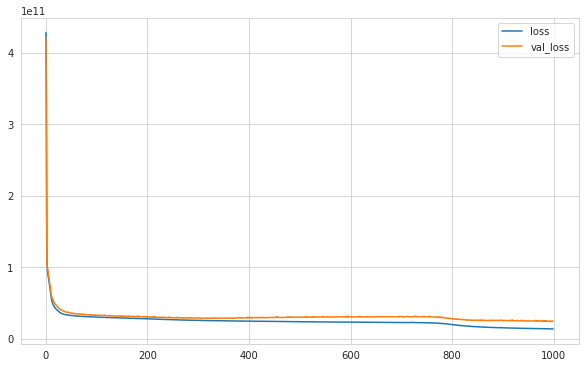

In [171]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot();

In [172]:
y_pred = model.predict(X_test)

In [173]:
eval_metric(y_test, y_pred)

r2_score: 0.8731953217373898 
mae: 76787.30654568187 
mse: 16291834875.696447 
rmse: 127639.4722477982


### EarlyStopping

__EarlyStop,__ datadaki egitimin iyilesmedigini farkettiginde model egitimini durdurur.

In [174]:
from tensorflow.keras.callbacks import EarlyStopping

En iyi skorlarimizi aldigimiz sekliyle modelimizi tekrar kurduk (Yukaridaki modelin aynisi) :

In [175]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003)
model.compile(optimizer = opt, loss = 'mse')

__monitor :__ Model egitilirken val_los' u gozlemle.

__patience :__ 25 iterasyona kadar skorda iyilesme olmazsa egitimi durdur dedik. Bu deger genellikle 20-25 civarinda secilir. Cok buyuk data setlerinde 2 veya 3 de yazilabiliyor. Olmasi gerekenden cok yuksek olursa overfite gitme durumu olabilir. Bu durumu plot gorselinde cizginin asagi indikten sonra tekrar yukari dogru cikma egiliminde oldugu durumlarda gozlemleyebiliriz.

__mode :__ min, max, auto degerlerini alabilir. Mesela classification problemlerinde accuracy gibi skorlarin buyuk olmasini isteyecegiz. O zaman max degerini secmemiz gerekecek. Burda ise regression problemi ile ugrastigimiz icin min degeri bulmamiz gerekiyor. 'auto' olarak secersek kendisi min-max secimini otomatik olarak yapiyor. (Default=auto)

In [176]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

Asagidaki ciktida val_los degerini incelersek; patient=25' e gore model 317' ye kadar iyilesen skorlar yakalamis, 317' den sonraki 25 islem boyunca daha iyi bir skor bulamadigi icin 25 adim sonra egitimi durdurmus :

In [177]:
model.fit(x = X_train, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000, callbacks = [early_stop])

Epoch 1/1000
130/130 [==============================] - 1s 4ms/step - loss: 428062736384.0000 - val_loss: 419663216640.0000
Epoch 2/1000
130/130 [==============================] - 0s 3ms/step - loss: 348343828480.0000 - val_loss: 181425520640.0000
Epoch 3/1000
130/130 [==============================] - 0s 3ms/step - loss: 108675309568.0000 - val_loss: 103254376448.0000
Epoch 4/1000
130/130 [==============================] - 0s 3ms/step - loss: 93860659200.0000 - val_loss: 99181690880.0000
Epoch 5/1000
130/130 [==============================] - 0s 3ms/step - loss: 89556877312.0000 - val_loss: 94929657856.0000
Epoch 6/1000
130/130 [==============================] - 0s 3ms/step - loss: 84964990976.0000 - val_loss: 90089545728.0000
Epoch 7/1000
130/130 [==============================] - 0s 3ms/step - loss: 80082558976.0000 - val_loss: 85358968832.0000
Epoch 8/1000
130/130 [==============================] - 0s 3ms/step - loss: 74900643840.0000 - val_loss: 79852060672.0000
Epoch 9/1000
130/1

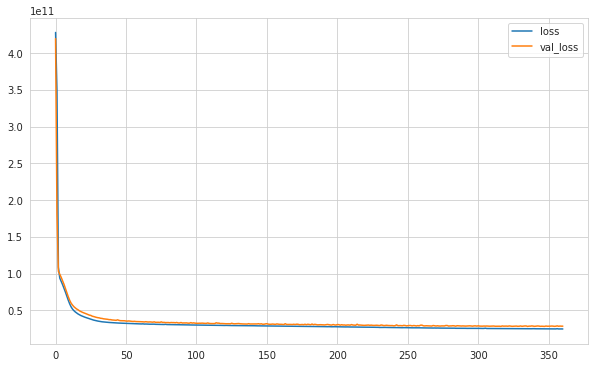

In [178]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [179]:
y_pred = model.predict(X_test)

EarlyStop isleminden sonra skorlarimiz dustu. Demek ki 25 patient' tan sonra daha dusuk degeri bulabilecegi bir nokta vardi fakat biz early stop ile modeli durdurdugumuz icin o noktaya kadar gidemedi. Early stop degeri yukseltilebilir veya yukarida kurdugumuz modelde __overfit durumu olmadigi icin early stop kullanmamiza da gerek yok__ : 

In [180]:
eval_metric(y_test, y_pred)

r2_score: 0.8221755787527776 
mae: 94708.9199327257 
mse: 22846839308.453754 
rmse: 151151.70957833642


### Dropout

__Droput,__ early stop gibi overfiti engellemek icin kullanilir. 

The Dropout layer randomly sets input units to 0 with a frequency of `rate`
at each step during training time, which helps prevent overfitting.

In [181]:
from tensorflow.keras.layers import Dropout

Modelimizi en iyi skorlari aldigimiz sekliyle tekrar tanimladik. Her layer' dan sonra dropout ekledik. Anlami ise __"29 tane nörondan her seferinde %20' sini calistirma"__ Her iterasyonda kapattigi nöronlari random olarak degistirir. Data cok fazla ezber yapip overfite gidiyorsa, ezberini bozmak icin her seferinde baska bir yeri kapatilir ve bu sekilde modelin ezberlemesi onlenmis olur. Dropout her katmana konmak zorunda degildir :

In [182]:
tf.random.set_seed(seed)   #dropout islemi de dahil tum islemler sonucu alacagimiz skorlari bununla sabitliyoruz.

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dropout(0.2))
model.add(Dense(29, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(15, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(8, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(1))

opt = Adam(lr = 0.003)
model.compile(optimizer = opt, loss = 'mse')

In [183]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

In [184]:
model.fit(x = X_train, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000, callbacks = [early_stop])

Epoch 1/1000
130/130 [==============================] - 1s 4ms/step - loss: 427572002816.0000 - val_loss: 414624251904.0000
Epoch 2/1000
130/130 [==============================] - 0s 3ms/step - loss: 272045604864.0000 - val_loss: 106626039808.0000
Epoch 3/1000
130/130 [==============================] - 0s 3ms/step - loss: 127681044480.0000 - val_loss: 101564825600.0000
Epoch 4/1000
130/130 [==============================] - 0s 3ms/step - loss: 115980656640.0000 - val_loss: 94682439680.0000
Epoch 5/1000
130/130 [==============================] - 0s 3ms/step - loss: 111958171648.0000 - val_loss: 88348622848.0000
Epoch 6/1000
130/130 [==============================] - 0s 3ms/step - loss: 105106890752.0000 - val_loss: 82633883648.0000
Epoch 7/1000
130/130 [==============================] - 0s 3ms/step - loss: 98024972288.0000 - val_loss: 74033315840.0000
Epoch 8/1000
130/130 [==============================] - 0s 3ms/step - loss: 89550905344.0000 - val_loss: 67734417408.0000
Epoch 9/1000
13

Bu datadan elde ettigimiz modelde overfit durumu yok. Biz ogrenmek adina dropout' u uyguladik. Bu islemden sonra skorlarimiz biraz dustu cunku datanin belli yerlerini kapatarak egitimi biraz engellemis olduk  :

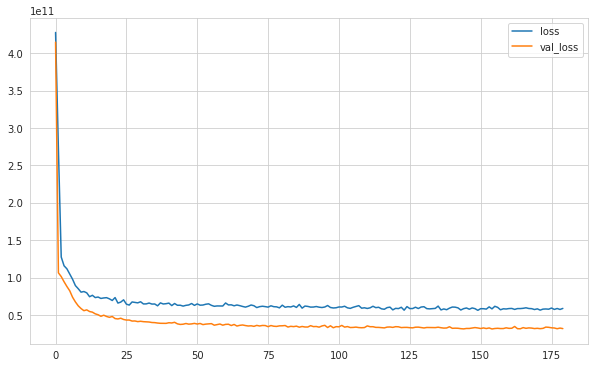

In [185]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [186]:
y_pred = model.predict(X_test)

In [187]:
eval_metric(y_test, y_pred)

r2_score: 0.7904547239053762 
mae: 101815.72779224536 
mse: 26922327187.69062 
rmse: 164080.24618366046


## Saving Final Model and Scaler

Daha sonra baska yerde kullanabilmek icin scaler' imizi dump ettik :

In [207]:
import pickle
pickle.dump(scaler, open("scaler_kc_house", 'wb'))

En iyi skorlari aldigimiz parametreler ile modelimizi olusturduk :

In [208]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003)
model.compile(optimizer = opt, loss = 'mse')

early_stop islemi ile modelin iyi egitilmedigini anladigimiz icin bu kodu calistirmadik :

In [190]:
#early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

Modelin tamami egitilirken de datayi X_train, y_train ve validation datalari olarak ayiriyoruz. Yukaridaki egitimlerde __validation_split__ kullanmistik. Burada kullandigimiz ise __validation_data__. Fit fonksiyonu icinde bu sekilde iki ayri validation parametresi var. validation_split secersek "Train datamin su kadarlik kismini validation icin ayir." demis oluyoruz. validation_data dedigimizde ise X_train ve y_train harici kalan test datalari validation islemi icin ayrilmis oluyor. Yani validation datasini train kismindan almadigimiz icin egitilen kisim yukariya gore daha fazla olmus oluyor :

In [209]:
model.fit(x = X_train, y = y_train, validation_data = (X_test, y_test), batch_size = 128, epochs = 1000,
         # callbacks = [early_stop]
         )

Epoch 1/1000
152/152 [==============================] - 1s 3ms/step - loss: 426416144384.0000 - val_loss: 406002565120.0000
Epoch 2/1000
152/152 [==============================] - 0s 2ms/step - loss: 274798018560.0000 - val_loss: 94608293888.0000
Epoch 3/1000
152/152 [==============================] - 0s 2ms/step - loss: 97477066752.0000 - val_loss: 88555732992.0000
Epoch 4/1000
152/152 [==============================] - 0s 3ms/step - loss: 92657041408.0000 - val_loss: 83812974592.0000
Epoch 5/1000
152/152 [==============================] - 0s 2ms/step - loss: 87678459904.0000 - val_loss: 78632173568.0000
Epoch 6/1000
152/152 [==============================] - 0s 2ms/step - loss: 82362630144.0000 - val_loss: 73219350528.0000
Epoch 7/1000
152/152 [==============================] - 0s 3ms/step - loss: 76469280768.0000 - val_loss: 67131908096.0000
Epoch 8/1000
152/152 [==============================] - 0s 2ms/step - loss: 70028427264.0000 - val_loss: 60857552896.0000
Epoch 9/1000
152/152 

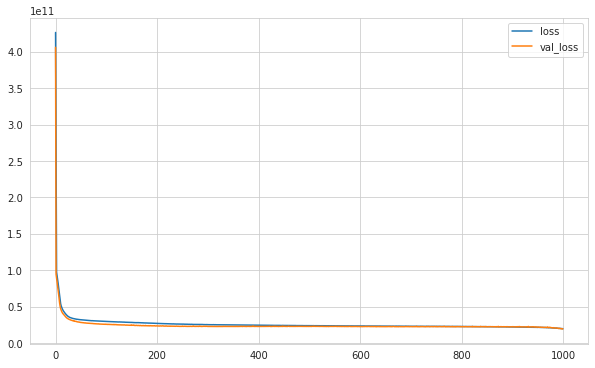

In [210]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot();

In [193]:
y_pred = model.predict(X_test)

Model kurma islemindekine gore data sayisi biraz daha arttigi icin skorlar biraz daha iyilesti :

In [194]:
eval_metric(y_test, y_pred)

r2_score: 0.8486736314794765 
mae: 84920.25385561342 
mse: 19442375802.329556 
rmse: 139435.92005767222


ML' den farkli olarak h5 uzantisi ile modelimizi kaydettik. Cunku ML modellerinde kac tane feature varsa sadece onlarin baslarindaki katsayilar kaydediliyordu. Burada ise kaydedilmesi gereken parametre cok fazla. Bu parametrelerin memory' de daha az yer kaplamasi icin h5 uzantisi ile kaydediyoruz :

In [195]:
model.save('model_kc_house.h5')  # creates a HDF5 file 'my_model.h5'

## Loading Model and Scaler

Save ettigimiz modelimizi tensorflow.keras icindeki load_model ile tekrar load edecegiz :

In [196]:
from tensorflow.keras.models import load_model

Scaler ve modelimizi cagirdik :

In [197]:
model_kc_house = load_model('model_kc_house.h5')
scaler_kc_house = pickle.load(open("scaler_kc_house", "rb"))

## Prediction

Prediction icin datamizdan bir veriyi kullandik. Datadaki ilk satiri sanki price sütununu düsürerek aldik, transform ile scale ettik, sonra da prediction' ı aldik :

In [198]:
single_house = df.drop('price', axis = 1).iloc[0:1, :]
single_house

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,47.511,-122.257,1340,5650,0,0,0,0,0,0,0,0,0,1,0,0


In [199]:
single_house = scaler_kc_house.transform(single_house)
single_house

array([[0.2       , 0.06666667, 0.06150342, 0.00307611, 0.        ,
        0.        , 0.        , 0.5       , 0.4       , 0.08960177,
        0.        , 0.47826087, 0.        , 0.57149751, 0.21760797,
        0.15304348, 0.00573322, 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 1.        , 0.        , 0.        ]])

In [200]:
model_kc_house.predict(single_house)

array([[271743.4]], dtype=float32)

Prediction' da aldigimiz fiyat ile gercek fiyati kiyasladik :

In [201]:
df.iloc[0][0]

221900.0

## Comparison with ML

### Linear Regression

DL ile aldigimiz skorlari ML modelleri ile karsilastiralim. Linear Regression' a gore DL' de daha iyi bir skor elde ettik. Ozellikle 'relu' kullaninca Artificial Network, Linear Regression' in boost hali gibi oldugu icin cikan sonuc oldukca mantikli. Linear regression' un bir ust sürümünü kullanmisiz gibi dusunebiliriz.

In [202]:
from sklearn.linear_model import LinearRegression 

In [203]:
ln_model = LinearRegression()
ln_model.fit(X_train, y_train)
y_pred = ln_model.predict(X_test)
eval_metric(y_test, y_pred)

r2_score: 0.7063549113317236 
mae: 124630.75277777777 
mse: 37727451086.11204 
rmse: 194235.55566917206


### Random Forest

Random Forest' tan aldigimiz skor ile DL modelinden aldigimiz skorlar birbirine cok yakin. DL modellerinin farki cok büyük data setlerinde ortaya cikar. 

DL' de modeller tekrarlardan ogrenir, ayni data defalarcda egitime girer. ML modellerden farki budur.

In [204]:
from sklearn.ensemble import RandomForestRegressor

In [205]:
rf_model = RandomForestRegressor(random_state = seed)
rf_model.fit(X_train, y_train)
y_pred = rf_model.predict(X_test)
eval_metric(y_test, y_pred)

r2_score: 0.8886293030442941 
mae: 64785.36375462963 
mse: 14308880631.643038 
rmse: 119619.73345415479


___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___